# Скачиваем датасет

In [1]:
!git clone https://github.com/MLP-The-Optimisers/Hotels-50K.git

Cloning into 'Hotels-50K'...
remote: Enumerating objects: 297, done.
remote: Counting objects: 100% (42/42), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 297 (delta 34), reused 34 (delta 32), pack-reused 255
Receiving objects: 100% (297/297), 112.96 MiB | 20.24 MiB/s, done.
Resolving deltas: 100% (149/149), done.


In [2]:
cd Hotels-50K/input

/content/Hotels-50K/input


In [3]:
!tar -xzvf 'dataset.tar.gz'

dataset/
dataset/chain_info.csv
dataset/._hotel_info.csv
dataset/._chain_info.csv
dataset/test_set.csv
dataset/train_set.csv
dataset/hotel_info.csv
dataset/._test_set.csv


In [4]:
cd ../

/content/Hotels-50K


Запускал на минуту!!! Так как нет желания все 1000000 фото скачивать...

In [5]:
!python download_train.py

/content/Hotels-50K/download_train.py:15: DeprecationWarning: AppURLopener style of invoking requests is deprecated. Use newer urlopen functions/methods
  opener = AppURLopener()
Good: ./images/train/3486.jpg
Good: ./images/train/3663.jpg
Good: ./images/train/2586939.jpg
Good: ./images/train/2586950.jpg
Good: ./images/train/2586951.jpg
Good: ./images/train/2586952.jpg
Good: ./images/train/2586986.jpg
Good: ./images/train/2586989.jpg
Good: ./images/train/2586991.jpg
Good: ./images/train/2587023.jpg
Good: ./images/train/2587024.jpg
Good: ./images/train/2587026.jpg
Good: ./images/train/2587067.jpg
Good: ./images/train/2587068.jpg
Good: ./images/train/2587069.jpg
Good: ./images/train/2587078.jpg
Good: ./images/train/2587081.jpg
Good: ./images/train/2587082.jpg
Good: ./images/train/2587086.jpg
Good: ./images/train/2587087.jpg
Good: ./images/train/2587089.jpg
Good: ./images/train/2587091.jpg
Good: ./images/train/2587093.jpg
Good: ./images/train/2587115.jpg
Good: ./images/train/2587116.jpg
Go

In [6]:
cd ../

/content


In [7]:
import os

def get_image_paths(folder_path):
    image_paths = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.endswith(".jpg"):
                image_path = os.path.join(root, file)
                image_paths.append(image_path)
    return image_paths

folder_path = "Hotels-50K/images"
image_paths = get_image_paths(folder_path)

In [8]:
len(image_paths)

100

Посмотрим, что скачали

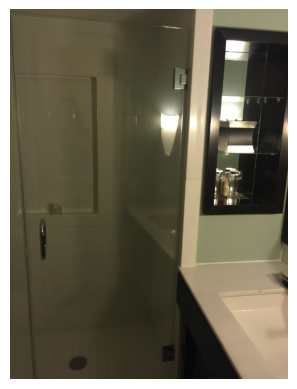

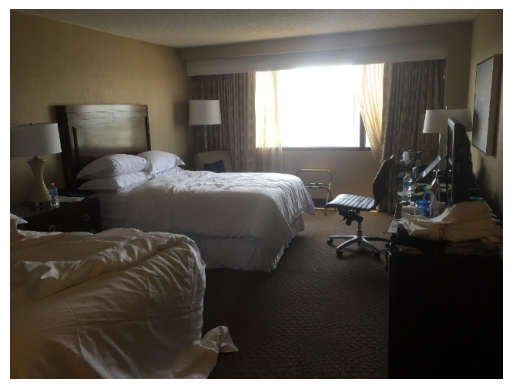

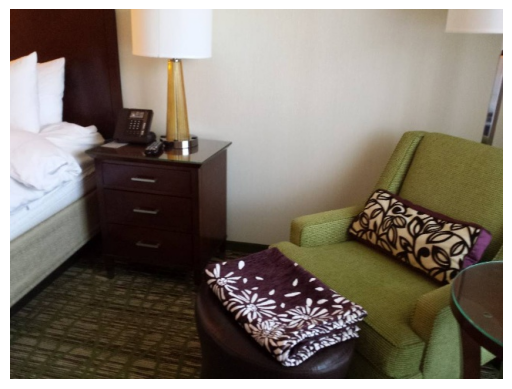

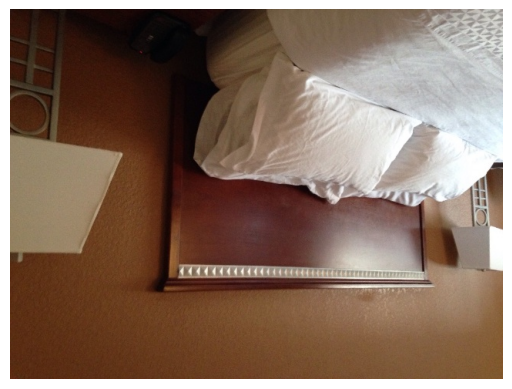

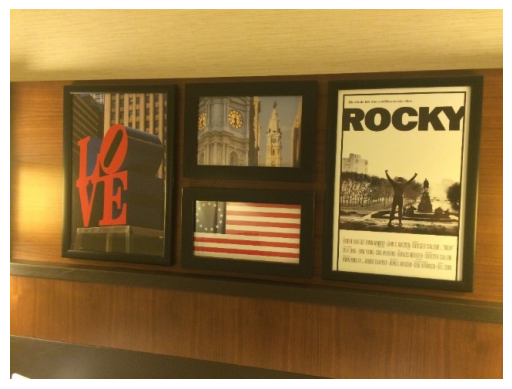

...

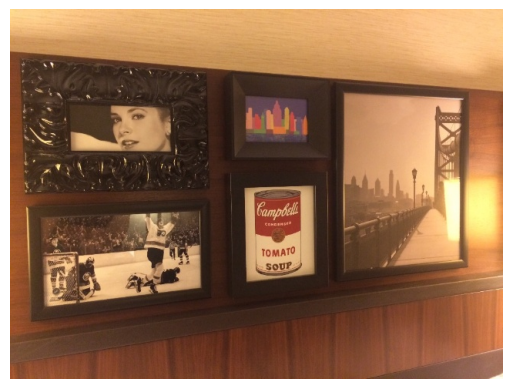

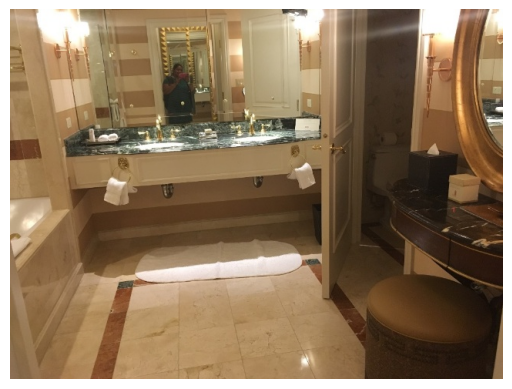

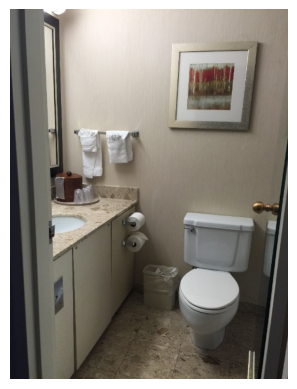

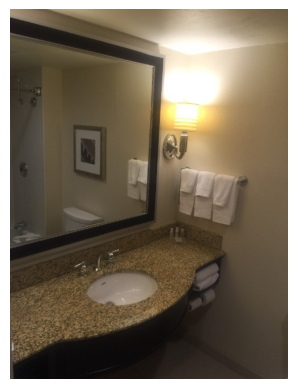

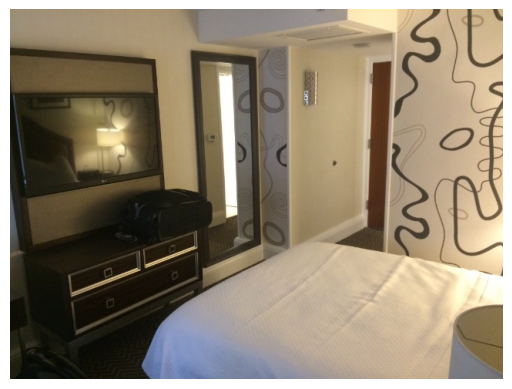

In [10]:
import matplotlib.pyplot as plt
from PIL import Image

for img_path in image_paths:
    img = Image.open(img_path)
    plt.axis('off')
    plt.imshow(img)
    plt.show()

# Скачиваем CLIP

In [28]:
%%shell

conda install --yes -c pytorch pytorch=1.7.1 torchvision cudatoolkit=11.0
pip install ftfy regex tqdm
pip install git+https://github.com/openai/CLIP.git

/bin/bash: line 2: conda: command not found
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-vbzmt3_w
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-vbzmt3_w
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done


Класс для датасетая

In [29]:
import torch

class HotelsDataset(torch.utils.data.Dataset):
    def __init__(self, img_paths, preprocess=None):
        self.img_paths = img_paths
        self.preprocess = preprocess

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img = Image.open(self.img_paths[idx])
        if self.preprocess is not None:
             img = self.preprocess(img)
        return img


Скачиваем большую версию clip на 900 мб

In [43]:
import clip

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-L/14", device=device)

dataset = HotelsDataset(image_paths)

In [53]:
tags_list = ['shower cabin',
            'corridor',
            'bath',
            'toilet',
            'table',
            'desk',
            'TV',
            'double bed',
            'single bed',
            'painting',
            'window view',
            'mirror',
            'chair',
            'large window',
            'large bed',
            'sofa',
            'closet',
            'air conditioner']

Сделаю класс для тегов, так как позже хочется посмотреть на статистику присваивании

In [54]:
class Tags():
  def __init__(self, name_tags):
      self.name_tags = name_tags
      self.usage_counter = {tag: 0 for tag in self.name_tags}

  def __len__(self):
      return len(self.name_tags)

  def __getitem__(self, idx):
      tag = self.name_tags[idx]
      self.usage_counter[tag] += 1
      return tag

tags_checker = Tags(tags_list)

# Инферим

Я тут немного напутал, нумерация тегов для фото не та, под первым должно было быть самое наивероятное и т.д., а получилось наоборот 😢. Итого 3 - самое наивероятное и дальне по уменьшению до 1

In [55]:
import numpy as np

def show_img_tag(image, tags_idx):
    plt.axis('off')
    title = '\n'.join([f'{i+1} - {tags_checker[idx]}' for i, idx in enumerate(tags_idx)])
    plt.title(title)
    plt.imshow(image)
    plt.show()

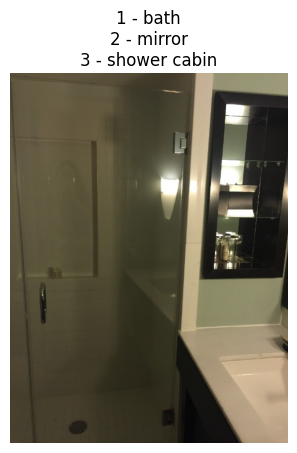

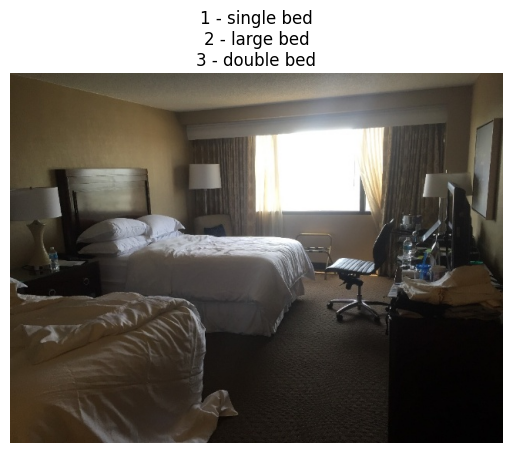

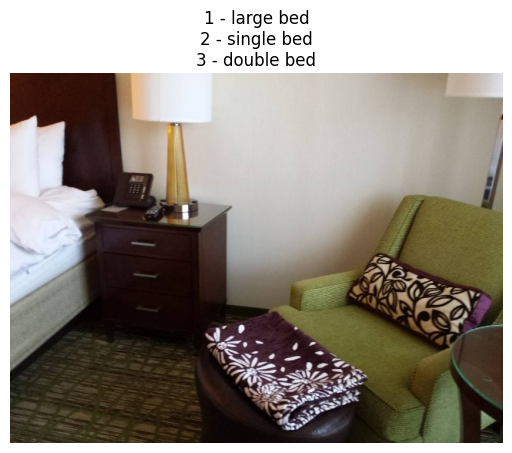

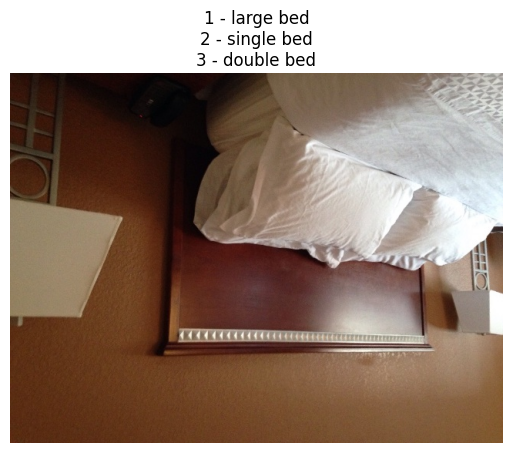

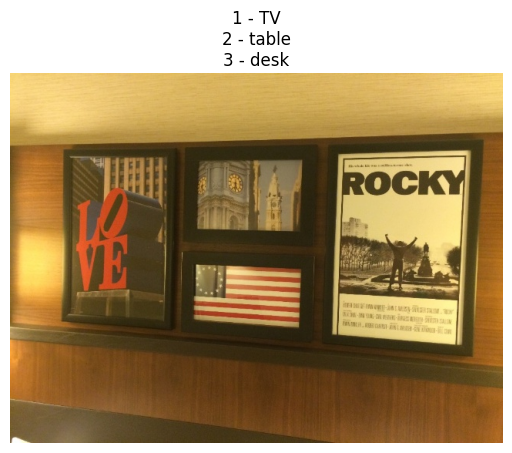

...

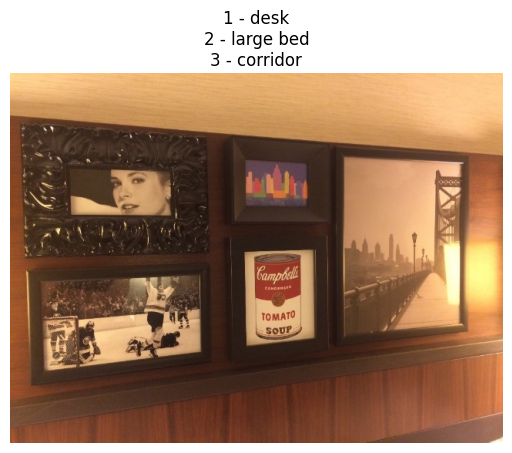

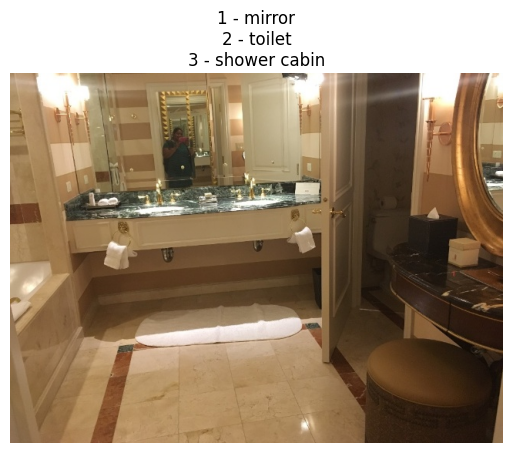

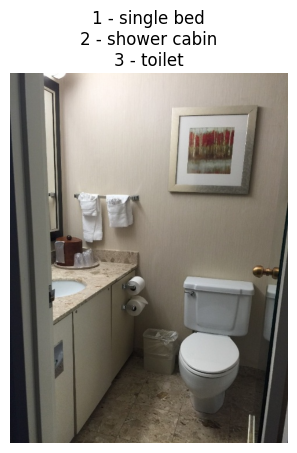

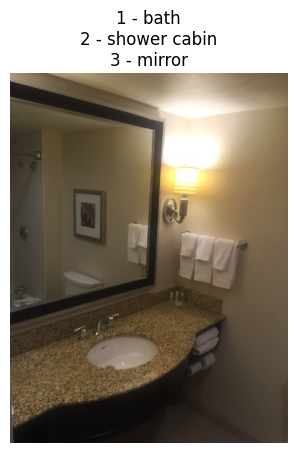

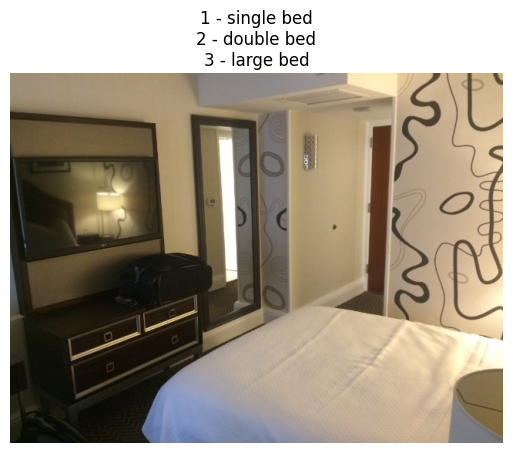

In [56]:
text = clip.tokenize(tags_list).to(device)

with torch.no_grad():
    for image in dataset:
        image_clip = preprocess(image).unsqueeze(0).to(device)

        logits_per_image, logits_per_tags = model(image_clip, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

        tags_idx = np.argsort(probs[0])[-3:]

        show_img_tag(image, tags_idx)


<BarContainer object of 18 artists>

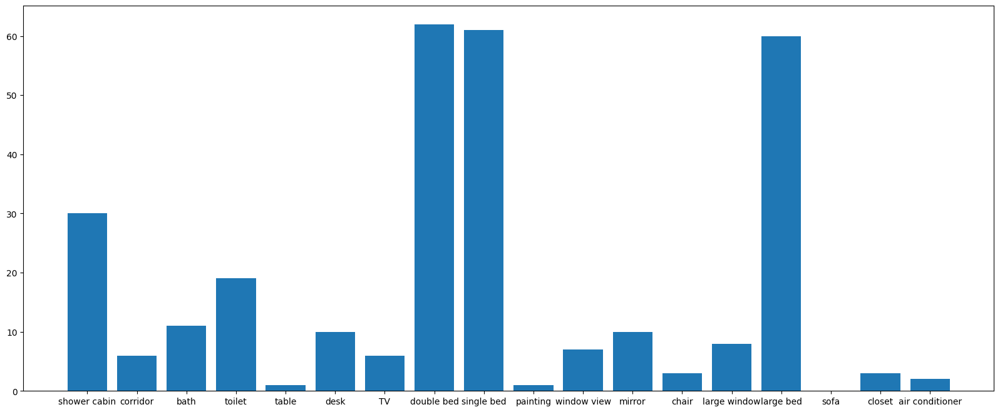

In [58]:
plt.figure(figsize=(20, 8))

plt.bar(tags_checker.usage_counter.keys(),
         tags_checker.usage_counter.values())

Результаты оказались предсказуемы, большая часть тегов относится к кроватям, либо к санузлам

# Запуск DiffusionMagic

In [1]:
# DiffusionMagic StableDiffusion XL 1.0
# Author : Rupesh Sreeraman
# Supports - Text to image SDXL
#          - Image to image SDXL
#          - Image variations SDXL(Give one image, and generate variations of it)
!git clone https://github.com/rupeshs/diffusionmagic.git

Cloning into 'diffusionmagic'...
remote: Enumerating objects: 887, done.
remote: Counting objects: 100% (338/338), done.
remote: Compressing objects: 100% (197/197), done.
remote: Total 887 (delta 212), reused 227 (delta 113), pack-reused 549
Receiving objects: 100% (887/887), 22.36 MiB | 752.00 KiB/s, done.
Resolving deltas: 100% (546/546), done.


In [2]:
!pip install accelerate==0.21.0 diffusers==0.19.3 gradio==3.39.0 safetensors==0.3.1 scipy==1.10.0 transformers==4.31.0 markupsafe==2.0.1 Pillow==9.3.0  invisible-watermark==0.2.0  controlnet-aux==0.0.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.2/244.2 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 59.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9 MB 63.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 72.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 103.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 110.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 96.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 33.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.2/66.2 kB 10.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.2/298.2 kB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.4/75.4 kB 10.9 MB/s eta 0:0

In [3]:
%cd diffusionmagic

/content/diffusionmagic


In [4]:
# Creates shareable link
!python src/app.py --share

2023-08-31 06:13:39.119000: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/pydantic/_internal/_fields.py:127: UserWarning: Field "model_id" has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/pydantic/_internal/_fields.py:127: UserWarning: Field "model_settings" has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(
DEVICE: Tesla T4 
/content/diffusionmagic/src/frontend/web/text_to_image_xl_ui.py:103: GradioDeprecationWarning: The `style` method is deprecated. Please set these arguments in the constructor instead.
  output = gr.Gallery(
/content/diffusionmagic/src/frontend/web/image_to_image_xl_ui.py:113: GradioDeprecationWarning: The `style` met